# Aprendizagem de Máquina I - Projeto 02

### Aluno: Guilherme Barão &nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;DRE: 121062490

## Introdução

Esse trabalho, como solicitado, consistirá na análise uma base de dados contendo informações sobre corridas de Uber, e na tentativa de prever o valor de novas corridas com base em atributos de interesse. A base de dados encontra-se disponível aqui: https://www.kaggle.com/datasets/yasserh/uber-fares-dataset

## Importando Bibliotecas:

In [72]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import numpy as np
import seaborn as sns
import geopy.distance
import matplotlib.pyplot as plt

## Importando e analisando os dados:

Importando os dados:

In [73]:
df = pd.read_csv('https://raw.githubusercontent.com/guij2/trabalho-apmaquina-2/main/uber.csv')
df.head()

,Unnamed: 0,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,24238194,2015-05-07 19:52:06.0000003,7.5,2015-05-07 19:52:06 UTC,-73.999817,40.738354,-73.999512,40.723217,1
1,27835199,2009-07-17 20:04:56.0000002,7.7,2009-07-17 20:04:56 UTC,-73.994355,40.728225,-73.994710,40.750325,1
2,44984355,2009-08-24 21:45:00.00000061,12.9,2009-08-24 21:45:00 UTC,-74.005043,40.740770,-73.962565,40.772647,1
3,25894730,2009-06-26 08:22:21.0000001,5.3,2009-06-26 08:22:21 UTC,-73.976124,40.790844,-73.965316,40.803349,3
4,17610152,2014-08-28 17:47:00.000000188,16.0,2014-08-28 17:47:00 UTC,-73.925023,40.744085,-73.973082,40.761247,5


Podemos observar a coluna contendo a nossa variável resposta "fare_amount", além de algumas possíveis covariáveis e colunas redundantes. Antes de mais nada, vamos checar por valores faltantes:

In [74]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 9 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   Unnamed: 0         200000 non-null  int64  
 1   key                200000 non-null  object 
 2   fare_amount        200000 non-null  float64
 3   pickup_datetime    200000 non-null  object 
 4   pickup_longitude   200000 non-null  float64
 5   pickup_latitude    200000 non-null  float64
 6   dropoff_longitude  199999 non-null  float64
 7   dropoff_latitude   199999 non-null  float64
 8   passenger_count    200000 non-null  int64  
dtypes: float64(5), int64(2), object(2)
memory usage: 13.7+ MB


Como podemos ver, apenas uma linha da base de dados possui valores faltantes, então podemos removê-la sem prejudicar de forma relevante a análise. Além disso, também podemos remover as colunas "Unnamed: 0", por se tratar apenas de um índice, e a coluna "key", por ser redundante com a "pickup_datetime" e já termos essa informação para todas as linhas. Vamos também converter a "pickup_datetime" para o dtype de datetime.

In [75]:
df = df.dropna()
df.drop(columns=['Unnamed: 0', 'key'],inplace=True)
df['pickup_datetime'] = pd.to_datetime(df['pickup_datetime'])

Agora vamos gerar algumas estatísticas descritivas das colunas:

In [76]:
df.describe()

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
count,199999.000000,199999.000000,199999.000000,199999.000000,199999.000000,199999.000000
mean,11.359892,-72.527631,39.935881,-72.525292,39.923890,1.684543
std,9.901760,11.437815,7.720558,13.117408,6.794829,1.385995
min,-52.000000,-1340.648410,-74.015515,-3356.666300,-881.985513,0.000000
25%,6.000000,-73.992065,40.734796,-73.991407,40.733823,1.000000
50%,8.500000,-73.981823,40.752592,-73.980093,40.753042,1.000000
75%,12.500000,-73.967154,40.767158,-73.963658,40.768001,2.000000
max,499.000000,57.418457,1644.421482,1153.572603,872.697628,208.000000


De cara já podemos perceber uma série de erros na base de dados. Corridas com preço negativo, latitudes e longitudes inexistentes, e corridas com 0 e 200 passageiros. Precisaremos corrigir esses problemas.

## Manipulando os dados:

Antes de mais nada, vamos gerar boxplots para as variáveis numéricas:

fare_amount             Axes(0.125,0.53;0.227941x0.35)
pickup_longitude     Axes(0.398529,0.53;0.227941x0.35)
pickup_latitude      Axes(0.672059,0.53;0.227941x0.35)
dropoff_longitude       Axes(0.125,0.11;0.227941x0.35)
dropoff_latitude     Axes(0.398529,0.11;0.227941x0.35)
passenger_count      Axes(0.672059,0.11;0.227941x0.35)
dtype: object

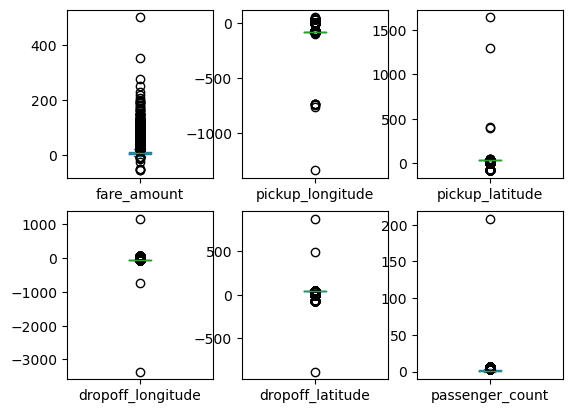

In [77]:
df_numerico = df.select_dtypes(exclude=[object,'datetimetz'])
df_numerico.plot(kind='box',subplots=True,layout=(2,3))

Felizmente, os valores impossíveis que encontramos no describe parecem ser apenas outliers. Vamos então removê-los dos nossos dados:

In [78]:
df_original = df.copy()
df = df.loc[(df.fare_amount > 0) & (df.passenger_count > 0) & (df.passenger_count < 20)]

"Existem pelo menos quatro modos de designar uma localização exata para qualquer ponto na superfície do globo terrestre.

Nos três primeiros sistemas, o globo é dividido em latitudes, que vão de 0 a 90 graus (norte ou sul) e longitudes, que vão de 0 a 180 graus (Leste ou Oeste)"

https://pt.wikipedia.org/wiki/Coordenadas_geográficas

In [79]:
df = df.loc[(df.pickup_latitude<90) & (df.dropoff_latitude<90) &
        (df.pickup_latitude>-90) & (df.dropoff_latitude>-90) &
        (df.pickup_longitude<180) & (df.dropoff_longitude<180) &
        (df.pickup_longitude>-180) & (df.dropoff_longitude>-180)]

Vamos agora ver quantas linhas restaram na nossa base de dados após remover essas linhas com valores impossíveis:

In [80]:
(len(df) / len(df_original)) * 100

99.62849814249071

Como podemos ver, as colunas removidas representavam menos de 0.5% dos nossos dados. Dessa forma, não devemos ter problemas por conta disso, e poderemos prosseguir com nossa análise. Antes disso, pode ser interessante também criar uma coluna com a distância percorrida pela viagem, que pode ter forte poder explicativo para nossos modelos:

In [81]:
df['distancia_percorrida']=[round(geopy.distance.distance((df.pickup_latitude[i], df.pickup_longitude[i]),
														  (df.dropoff_latitude[i], df.dropoff_longitude[i])).km,2) for i in df.index]

Vamos também separar a informação do momento da viagem em várias colunas, para analisar individualmente o poder explicativo das diferentes unidades de tempo contidas nessa informação.

In [82]:
df['ano'] = df.pickup_datetime.dt.year
df['dia_semana'] = df.pickup_datetime.dt.weekday
df['trimestre'] = pd.PeriodIndex(df.pickup_datetime, freq='Q')
df['trimestre'] = df['trimestre'].astype(str).str[-1:]
df['trimestre'] = df['trimestre'].astype(int)
df['hora'] = df.pickup_datetime.dt.hour
df.drop(columns='pickup_datetime',inplace=True)

In [83]:
df.head()

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,distancia_percorrida,ano,dia_semana,trimestre,hora
0,7.5,-73.999817,40.738354,-73.999512,40.723217,1,1.68,2015,3,2,19
1,7.7,-73.994355,40.728225,-73.994710,40.750325,1,2.45,2009,4,3,20
2,12.9,-74.005043,40.740770,-73.962565,40.772647,1,5.04,2009,0,3,21
3,5.3,-73.976124,40.790844,-73.965316,40.803349,3,1.66,2009,4,2,8
4,16.0,-73.925023,40.744085,-73.973082,40.761247,5,4.48,2014,3,3,17


A nossa base de dados parece estar em um bom formato agora, então vamos começar a analisar as variáveis.

## Analisando as variáveis:

Em primeiro lugar, vamos gerar o mapa de correlações da base de dados:

<Axes: >

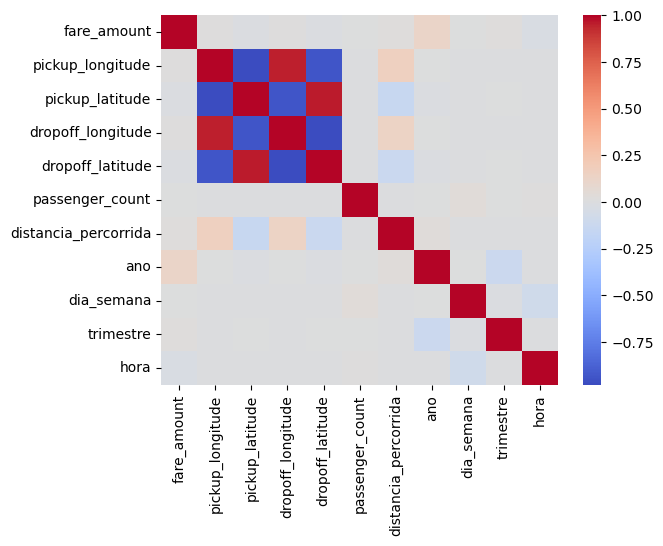

In [84]:
sns.heatmap(df.corr(numeric_only=True), cmap='coolwarm')

Olhando de cara, não parece que temos nenhuma correlação forte das variáveis com a variável resposta. Nem mesmo a distância percorrida, que deveria ser o fator mais relevante no preço, parece apresentar correlação. Vamos observar o que está acontecendo:

In [85]:
px.scatter(df,x='distancia_percorrida',y='fare_amount')

Parece que temos muitos outliers que estão influenciando nossos resultados. Além de corridas com 0 de distância percorrida, o que não faz qualquer sentido, ainda temos algumas corridas de mais de milhares de quilômetros por preços minúsculos, que também parecem ser erros na base de dados. Vamos tentar remover esses outliers e ver como isso afeta nossa análise.

In [86]:
df = df.loc[(df.distancia_percorrida < 1000) & (df.distancia_percorrida > 0)]
px.scatter(df,x='distancia_percorrida',y='fare_amount')

Nossos dados parecem ter melhorado, mas ainda temos alguns outliers prejudicando a análise. Vamos tentar diminuir a tolerância da remoção gradualmente e ver o que acontece:

In [87]:
df = df.loc[(df.distancia_percorrida < 200)]
px.scatter(df,x='distancia_percorrida',y='fare_amount')

In [88]:
df = df.loc[(df.distancia_percorrida < 80)]
px.scatter(df,x='distancia_percorrida',y='fare_amount')

Os dados agora parecem fazer bem mais sentido. Vamos ver o mapa de correlações agora:

<Axes: >

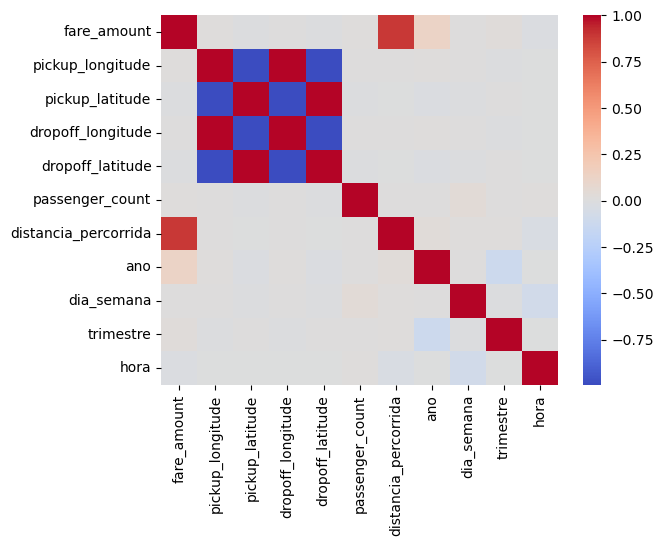

In [89]:
sns.heatmap(df.corr(numeric_only=True), cmap='coolwarm')

In [90]:
(len(df) / len(df_original)) * 100

96.40448202241011

Podemos observar uma correlação bem maior da distância percorrida com o preço das corridas após a remoção das linhas com erro e dos outliers, e ainda temos mais de 96% dos dados originais disponíveis. Vamos observar agora a distribuição das nossas corridas pelo mundo:

In [91]:
fig = px.scatter_geo(df,lat=df.pickup_latitude,lon=df.pickup_longitude)
fig.show()

Parece haver algo estranho na localização das corridas. Além da cidade de Nova York, parecem ter sido coletados dados de corridas no meio do oceano atlântico nas coordenadas (0,0) e na Antártica, onde os serviços da Uber obviamente não estão dispoíveis.

No entanto, ao observarmos os valores das coordenadas, conseguimos entender o que provavelmente aconteceu: O local na Antártica onde foram registradas as corridas tem as coordenadas exatamente opostas às da cidade de Nova York, portanto, provavelmente estas linhas estão com os valores de latitude e longitude trocados. Vamos, então, destrocá-los:

In [92]:
df.loc[df['pickup_latitude'] < -70, ['pickup_latitude', 'pickup_longitude']] = df.loc[df['pickup_latitude'] < -70, ['pickup_longitude', 'pickup_latitude']].values
df.loc[df['dropoff_latitude'] < -70, ['dropoff_latitude', 'dropoff_longitude']] = df.loc[df['dropoff_latitude'] < -70, ['dropoff_longitude', 'dropoff_latitude']].values


No caso das corridas aceitas nas coordenadas (0,0), no entanto, provavelmente houve algum erro no registro da localização. Como não há como saber se as distâncias foram registradas corretamente, talvez seja ideal remover essas linhas da nossa base de dados.

In [93]:
print(f"Número de linhas removidas: {len(df.loc[abs(df['pickup_longitude'])<=1])}")
df=df.loc[abs(df['pickup_longitude'])>1]


Número de linhas removidas: 15


In [94]:
fig = px.scatter_geo(df,lat=df.pickup_latitude,lon=df.pickup_longitude)
fig.show()

Agora os dados parecem fazer mais sentido. Algumas viagens também parecem ter sido aceitas ligeiramente fora da costa da cidade, mas podemos atribuir isso a uma pequena imprecisão do GPS. Aparentemente, nossa base de dados apresenta quase que exclusivamente corridas registradas na cidade de Nova York. Se não fosse esse o caso, poderia ser interessante criar uma coluna com o país da corrida, visto que isso deve impactar bastante nos preços, mas não teremos esse problema aqui. Mesmo assim, pode ser interessante manter essas variáveis, visto que o preço pode mudar dependendo da região da cidade. Na verdade, esse parece o momento ideal para analisarmos novamente o mapa de correlações:

<Axes: >

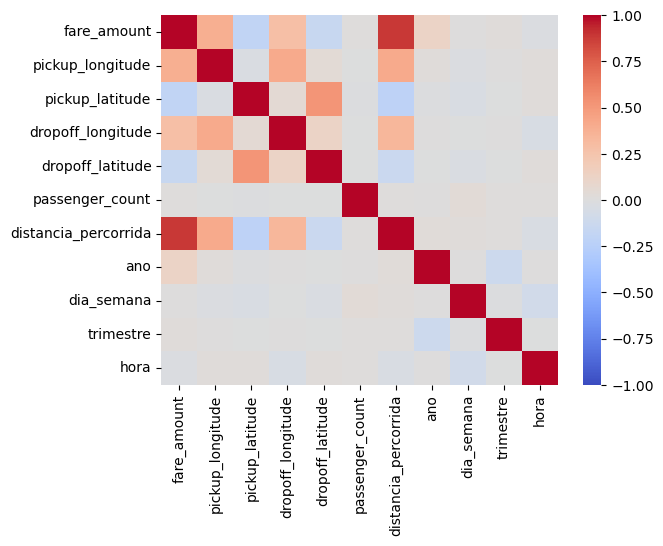

In [95]:
sns.heatmap(df.corr(),cmap='coolwarm',vmin=-1,vmax=1)

Temos algumas observações interessantes para fazer aqui: Em primeiro lugar, a correlação entre as latitudes e longitudes diminuiu bastante, provavelmente por conta da correção nos valores invertidos. Além disso, essas variáveis agora tem uma correlação maior com a variável resposta, além da variável distância percorrida. Essas alterações parecem promissoras, e pode ser interessante se aprofundar mais nisso.

In [96]:
df_temp = df.round(decimals=2)
df_temp = df_temp.groupby(['pickup_latitude','pickup_longitude'],as_index=False).mean()
fig = px.scatter_mapbox(df_temp,lat='pickup_latitude',lon='pickup_longitude',size='fare_amount',mapbox_style="carto-positron", title='Preço médio das viagens por local de início')
fig.update_layout(margin = dict(l = 0, r = 0, t = 0, b = 0), title_y = 0.05, title_x = 0.5)
fig.show()

Podemos observar que as corridas tendem a ser mais caras quando iniciadas mais distantes de Manhattan, possivelmente porque a maioria das viagens num geral têm Manhattan como destino, e as viagens iniciadas mais longe são mais caras. Vamos ver agora o preço por destinos:

In [97]:
df_temp = df.round(decimals=2)
df_temp = df_temp.groupby(['dropoff_latitude','dropoff_longitude'],as_index=False).mean()
fig = px.scatter_mapbox(df_temp,lat='dropoff_latitude',lon='dropoff_longitude',size='fare_amount',mapbox_style="carto-positron", title='Preço médio das viagens por local de destino')
fig.update_layout(margin = dict(l = 0, r = 0, t = 0, b = 0), title_y = 0.05, title_x = 0.5)
fig.show()

Destinos mais distantes de Manhattan também parecem apresentar maiores preços. Talvez por um efeito oposto ao mencionado anteriormente (as pessoas tendem a partir de Manhattan para voltar, e os destinos mais distantes são mais caros). De qualquer forma, essas variáveis parecem interessantes o suficiente para manter no modelo.

Vamos prosseguir com a análise investigando a relação das demais covariáveis com o preço da viagem, começando pelo número de passageiros:

<Axes: xlabel='passenger_count', ylabel='fare_amount'>

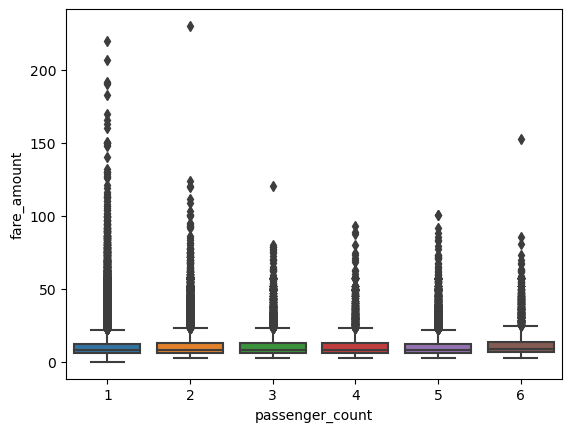

In [98]:
sns.boxplot(df,x='passenger_count',y='fare_amount')

Os outliers estão dificultando um pouco a visualização, então vamos removê-los temporariamente:

<Axes: xlabel='passenger_count', ylabel='fare_amount'>

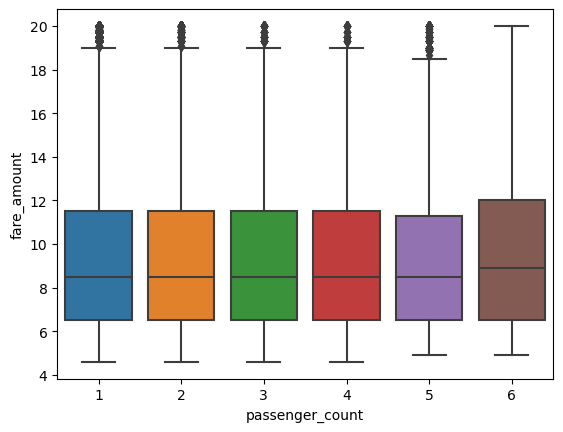

In [99]:
df_temp = df.copy()
percentis = df_temp['fare_amount'].quantile([0.1, 0.9]).values
df_temp=df_temp[(df_temp['fare_amount'] > percentis[0]) & (df_temp['fare_amount'] < percentis[1])]
sns.boxplot(data=df_temp, x='passenger_count', y='fare_amount')

Aparentemente, o número de passageiros não representa muito impacto nos preços, com destaque para as corridas com 6 passageiros que possuem uma média um pouco mais alta da variável resposta.

Agora, vamos dar uma olhada nas variáveis de tempo, começando pelo dia da semana:

<Axes: xlabel='dia_semana', ylabel='fare_amount'>

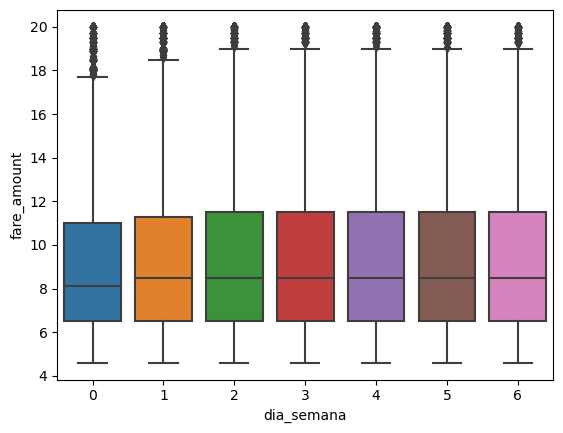

In [100]:
sns.boxplot(df_temp,x='dia_semana',y='fare_amount')

(Os valores começam na segunda-feira, segundo a [documentação do Pandas](https://pandas.pydata.org/docs/reference/api/pandas.Series.dt.weekday.html).) Como podemos ver, o dia da semana também não parece ter muito impacto nos valores, com exceção da segunda feira que apresenta preços menores num geral.

<Axes: xlabel='hora', ylabel='fare_amount'>

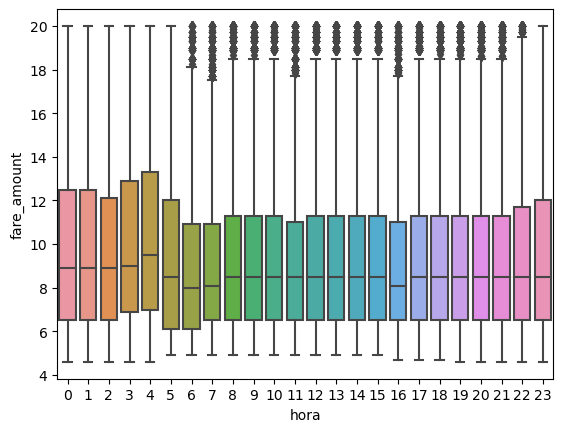

In [101]:
sns.boxplot(df_temp,x='hora',y='fare_amount')

Já nas horas, observamos que os valores apresentam preços estáveis durante a tarde e a noite, com um aumento repentino na madrugada e uma queda na parte da manhã.

<Axes: xlabel='trimestre', ylabel='fare_amount'>

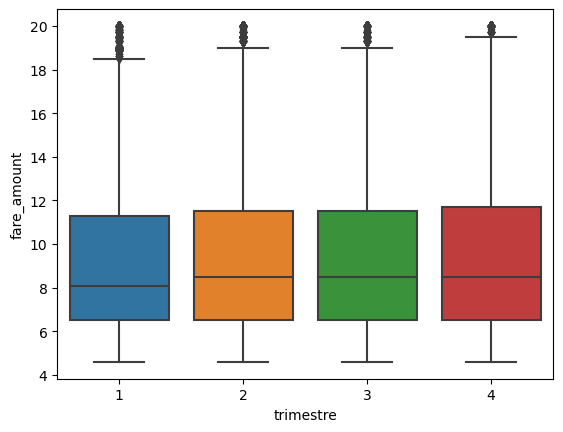

In [102]:
sns.boxplot(df_temp,x='trimestre',y='fare_amount')

Quanto aos trimestres, os valores das corridas parecem ser mais baixos no começo do ano porém aumentam e se mantém estáveis até o final.

<Axes: xlabel='ano', ylabel='fare_amount'>

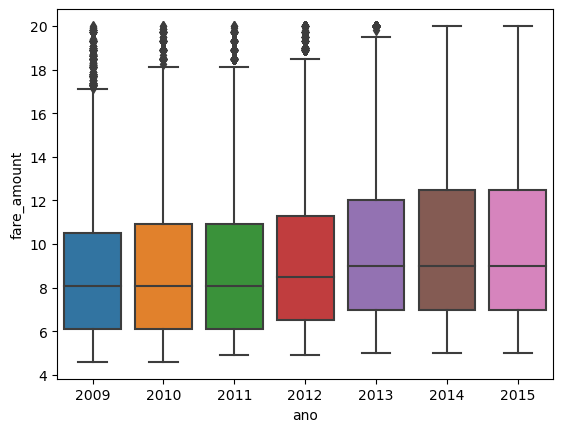

In [103]:
sns.boxplot(df_temp,x='ano',y='fare_amount')

Já quanto ao ano, podemos observar uma clara tendência de aumento com o tempo, provavelmente devido à inflação e talvez à solidificação do aplicativo no mercado.  Entre as variáveis que observamos agora, essa parece ter a relação mais pronunciada, o que explica o seu valor mais alto de correlação.

Todas as variáveis parecem ter poder explicativo relevante, mesmo que algumas tenham pouco, então pode ser interessante mantê-las para o ajuste dos modelos. No entanto, pode ser uma boa ideia agrupar as variáveis de número de passageiros, dia da semana e trimestre em subgrupos, dada sua natureza:
- Número de passageiros: 1 se forem 6 passageiros, 0 caso contrário
- Dia da semana: 1 se for segunda feira, 0 se não for segunda feira
- Trimestre: 1 se for o primeiro trimestre, 0 se não for o primeiro trimestre

In [104]:
df['passenger_count'] = df.passenger_count.map({6:1,1:0,2:0,3:0,4:0,5:0})
df['dia_semana'] = df.dia_semana.map({0:1,1:0,2:0,3:0,4:0,5:0,6:0})
df['trimestre'] = df.trimestre.map({1:1,2:0,3:0,4:0})

## Ajustando os modelos de regressão

Separando 25% dos dados para teste:

In [105]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

In [106]:
X = df.drop(columns=['fare_amount'])
y = df.fare_amount

X_treino, X_teste, y_treino, y_teste = train_test_split(
    X, y, test_size=0.25, random_state=1
)

Definindo funções para realizar o ajuste e a previsão, para economizar em linhas de código:

In [107]:
def ajuste_e_previsao(modelo, tipo='regressao', tabela=False):
    modelo.fit(X_treino, y_treino)
    y_pred = modelo.predict(X_teste)

    r2 = modelo.score(X_teste, y_teste)
    MSE = mean_squared_error(y_teste, y_pred)
    if tabela:
        return pd.DataFrame(data={'modelo':[type(modelo).__name__],'R2':[r2],'MSE':[MSE]})
    else:
        print('R-quadrado teste: ', r2)
        print('Erro quadrático médio: ', MSE)
        comparar_distribuicao(y_teste, y_pred)
        if tipo == 'floresta':
            print('\n')
            print(pd.DataFrame(zip(X.columns, modelo.feature_importances_),columns=['Covariável','Importância']))
        elif tipo == 'outros':
            pass
        else:
            print('\n')
            print(pd.DataFrame(zip(X.columns, modelo.coef_),columns=['Covariável','Coef encontrado']))

def comparar_distribuicao(y_test, y_pred):
    fig, ax = plt.subplots(1, 2, figsize=(16, 5))

    ax[0].hist(y_test, bins=100)
    ax[0].set_title('Distribuição real do fare_amount')
    ax[1].hist(y_pred, bins=100)
    ax[1].set_title('Distribuição prevista do fare_amount')

tabela_modelos = pd.DataFrame()

Importando os modelos que serão testados:

In [108]:
from sklearn.linear_model import LinearRegression, RidgeCV, LassoCV, ElasticNetCV
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import BaggingRegressor, RandomForestRegressor

### Modelos de Regressão paramétricos:

Nesses modelos, os coeficientes encontrados representam o quanto, em média, o preço da corrida se altera ao aumentar uma unidade no valor da covariável (no conjunto de treino). No caso do dia da semana, trimestre e contagem de passageiros, os coeficientes estão representando o quanto o preço da corrida se altera em média na segunda feira, no primeiro trimestre e com 6 passageiros, respectivamente.

#### Regressão Linear:

R-quadrado teste:  0.8060271416270763
Erro quadrático médio:  17.985203971654933


             Covariável  Coef encontrado
0      pickup_longitude        11.644622
1       pickup_latitude         9.414451
2     dropoff_longitude        -7.501073
3      dropoff_latitude       -12.217096
4       passenger_count         0.000617
5  distancia_percorrida         2.328221
6                   ano         0.511523
7            dia_semana        -0.213138
8             trimestre        -0.353152
9                  hora         0.009542


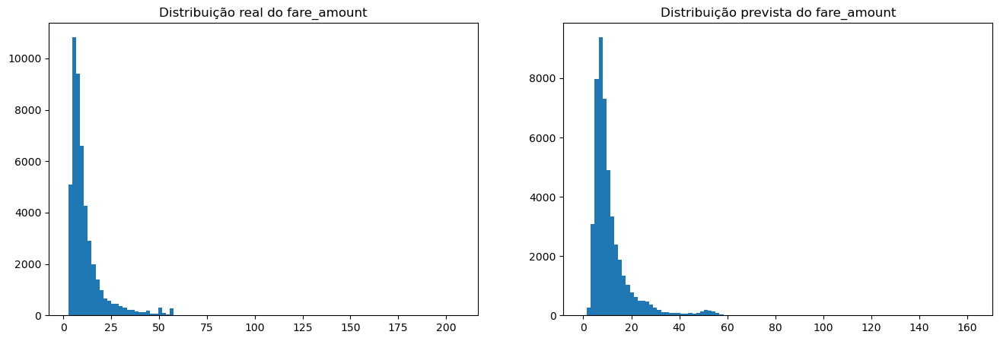

In [109]:
OLS = LinearRegression()
ajuste_e_previsao(OLS)
tabela_modelos = pd.concat([tabela_modelos, ajuste_e_previsao(OLS,tabela=True)])

#### Regressão Linear com penalização Ridge:

R-quadrado teste:  0.8060290463524571
Erro quadrático médio:  17.98502736511951


             Covariável  Coef encontrado
0      pickup_longitude        11.604169
1       pickup_latitude         9.344489
2     dropoff_longitude        -7.473439
3      dropoff_latitude       -12.153985
4       passenger_count         0.000673
5  distancia_percorrida         2.328250
6                   ano         0.511522
7            dia_semana        -0.213058
8             trimestre        -0.353157
9                  hora         0.009556


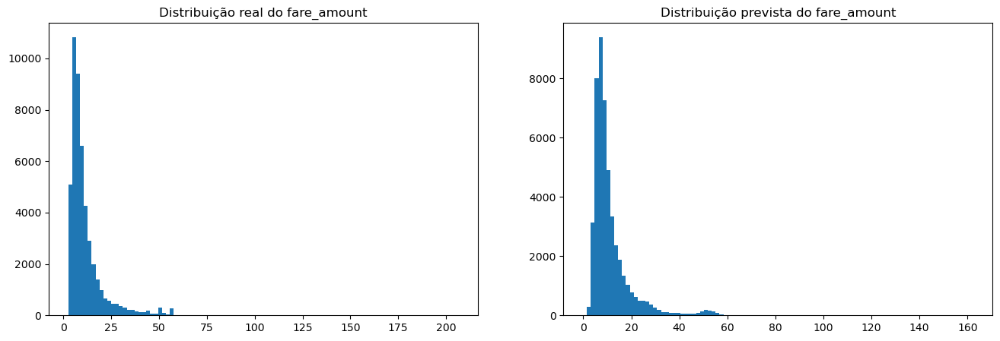

In [110]:
Ridge = RidgeCV(alphas=np.logspace(-6, 6, 50),cv=5)
    
ajuste_e_previsao(Ridge)
tabela_modelos = pd.concat([tabela_modelos, ajuste_e_previsao(Ridge,tabela=True)])

#### Regressão Linear com penalização Lasso:

R-quadrado teste:  0.8027378998826209
Erro quadrático médio:  18.290183153703065


             Covariável  Coef encontrado
0      pickup_longitude         0.000000
1       pickup_latitude         0.000000
2     dropoff_longitude        -0.000000
3      dropoff_latitude        -0.000000
4       passenger_count         0.000000
5  distancia_percorrida         2.348151
6                   ano         0.500487
7            dia_semana        -0.000000
8             trimestre        -0.194121
9                  hora         0.012063


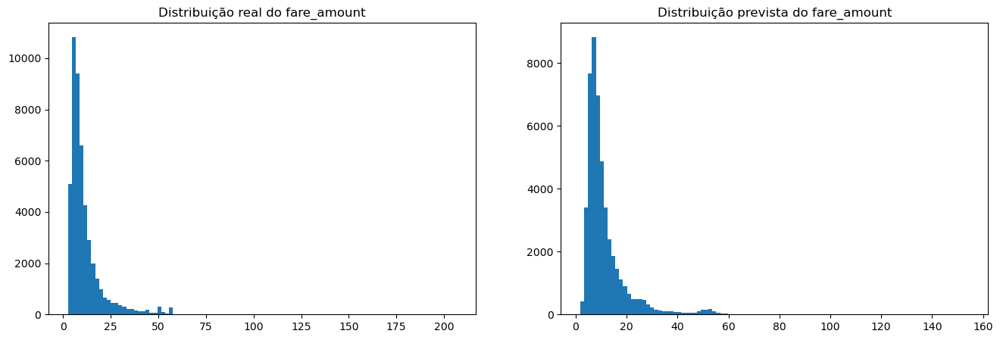

In [111]:
Lasso = LassoCV(n_alphas=50,cv=5)
    
ajuste_e_previsao(Lasso)
tabela_modelos = pd.concat([tabela_modelos, ajuste_e_previsao(Lasso,tabela=True)])

#### Regressão Linear com penalização ElasticNet:

R-quadrado teste:  0.8027378998826209
Erro quadrático médio:  18.290183153703065


             Covariável  Coef encontrado
0      pickup_longitude         0.000000
1       pickup_latitude         0.000000
2     dropoff_longitude        -0.000000
3      dropoff_latitude        -0.000000
4       passenger_count         0.000000
5  distancia_percorrida         2.348151
6                   ano         0.500487
7            dia_semana        -0.000000
8             trimestre        -0.194121
9                  hora         0.012063


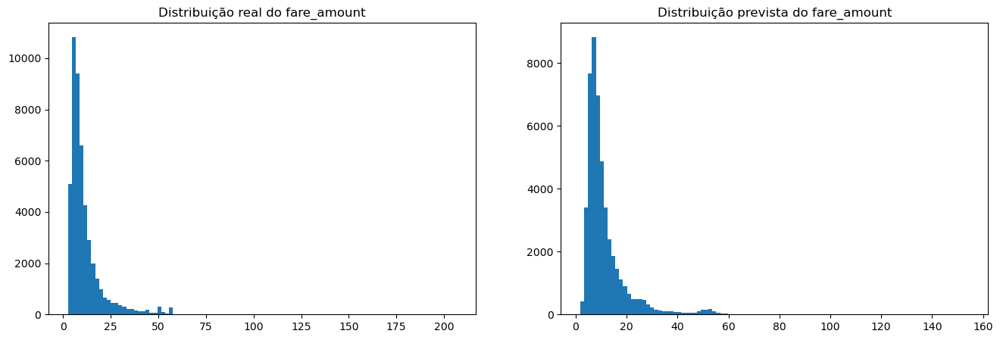

In [112]:
ElasticNet = ElasticNetCV(l1_ratio=np.linspace(0.1,1,10),n_alphas=50,cv=5)
ajuste_e_previsao(ElasticNet)
tabela_modelos = pd.concat([tabela_modelos, ajuste_e_previsao(ElasticNet,tabela=True)])

### Modelos de regressão não-paramétricos:

Esses modelos não apresentam coeficientes interpretáveis como os modelos usados anteriormente. No entanto, no caso dos modelos baseados em árvore, podemos utilizar o cálculo de "importância" para ver o quanto uma determinada covariável contribui para a redução da aleatoriedade da nossa previsão.

#### K-Neighbors:

R-quadrado teste:  0.8243994004957768
Erro quadrático médio:  16.28172428926372


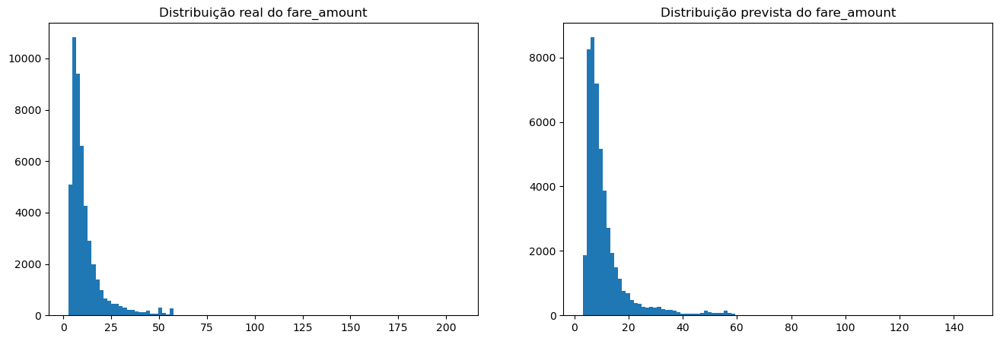

In [113]:
KNN = KNeighborsRegressor(weights='uniform',n_neighbors=15,p=2)


ajuste_e_previsao(KNN,tipo='outros')
tabela_modelos = pd.concat([tabela_modelos, ajuste_e_previsao(KNN,tipo='outros',tabela=True)])

#### Decision Tree:

R-quadrado teste:  0.8389542785919357
Erro quadrático médio:  14.932192949993981


             Covariável  Importância
0      pickup_longitude     0.007306
1       pickup_latitude     0.002060
2     dropoff_longitude     0.027750
3      dropoff_latitude     0.008644
4       passenger_count     0.000000
5  distancia_percorrida     0.929604
6                   ano     0.021982
7            dia_semana     0.000000
8             trimestre     0.000000
9                  hora     0.002655


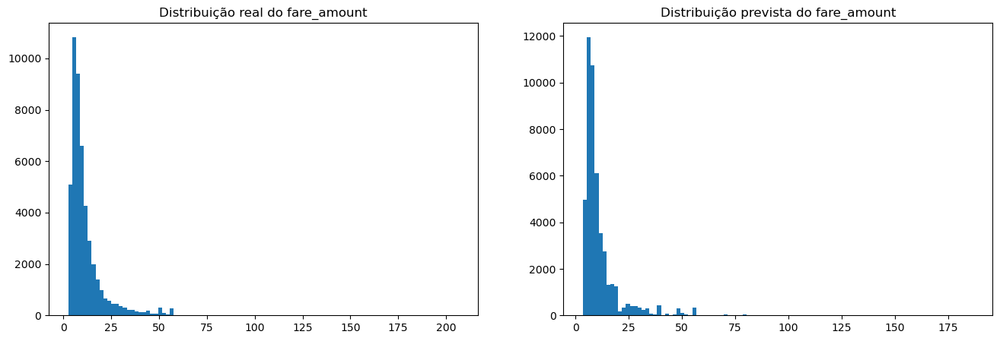

In [114]:
DTR = DecisionTreeRegressor(max_depth = None, min_samples_leaf = 5, ccp_alpha=0.01,random_state=1)
ajuste_e_previsao(DTR, tipo='floresta')
tabela_modelos = pd.concat([tabela_modelos, ajuste_e_previsao(DTR,tipo='floresta',tabela=True)])

#### Decision Tree com Bagging:

R-quadrado teste:  0.8537106000123528
Erro quadrático médio:  13.563983743594271


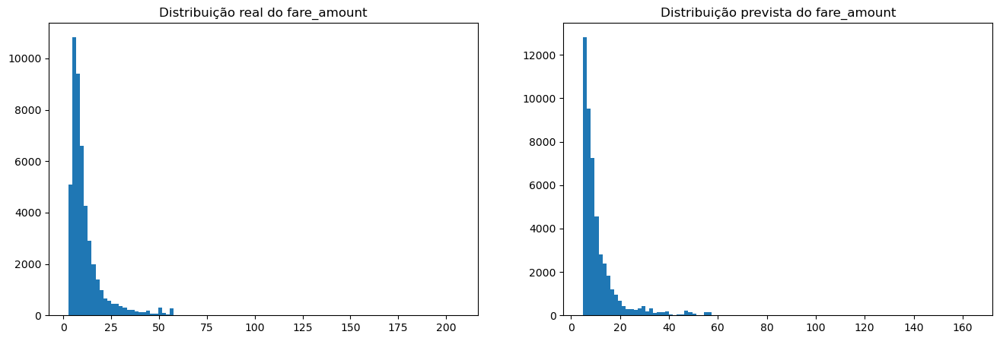

In [115]:
DTB = BaggingRegressor(estimator = DecisionTreeRegressor(max_depth = None, min_samples_leaf = 5, ccp_alpha=0.01,random_state=1), n_estimators = 100, random_state=1)
ajuste_e_previsao(DTB, tipo='outros')
tabela_modelos = pd.concat([tabela_modelos, ajuste_e_previsao(DTB,tipo='outros',tabela=True)])

#### Random Forest:

R-quadrado teste:  0.8671900600055248
Erro quadrático médio:  12.314165395612438


             Covariável  Importância
0      pickup_longitude     0.019151
1       pickup_latitude     0.012501
2     dropoff_longitude     0.038343
3      dropoff_latitude     0.021274
4       passenger_count     0.000099
5  distancia_percorrida     0.873644
6                   ano     0.023455
7            dia_semana     0.000392
8             trimestre     0.001052
9                  hora     0.010090


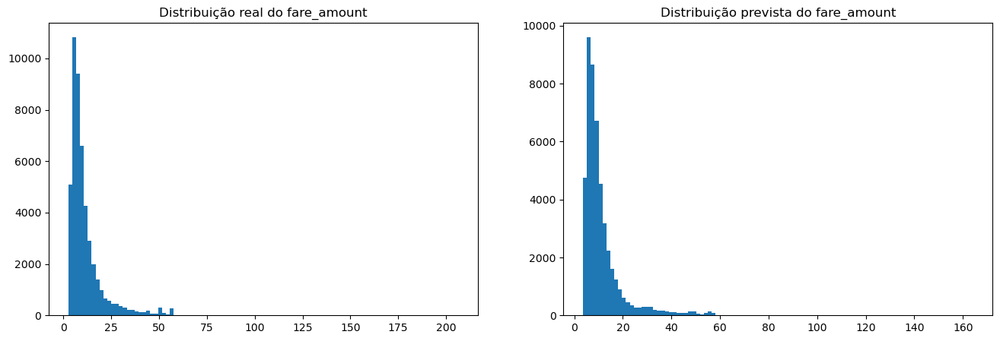

In [116]:
RandomForest = RandomForestRegressor(n_estimators=100, min_samples_leaf=5,random_state=1)
ajuste_e_previsao(RandomForest, tipo='floresta')
tabela_modelos = pd.concat([tabela_modelos, ajuste_e_previsao(RandomForest,tipo='floresta',tabela=True)])

In [117]:
print(tabela_modelos)

                  modelo        R2        MSE
0       LinearRegression  0.806027  17.985204
0                RidgeCV  0.806029  17.985027
0                LassoCV  0.802738  18.290183
0           ElasticNetCV  0.802738  18.290183
0    KNeighborsRegressor  0.824399  16.281724
0  DecisionTreeRegressor  0.838954  14.932193
0       BaggingRegressor  0.853711  13.563984
0  RandomForestRegressor  0.867190  12.314165


Como podemos ver, parece ideal escolher o modelo de Random Forest para realizar previsões de dados futuros, por ter apresentado maior R quadrado e menor erro quadrático médio quando testado no conjunto de teste, em comparação com os outros modelos. Por razões computacionais, não foi possível usar o GridSearchCV para testar os melhores hiperparâmetros dos modelos de regressão não paramétricos, mas talvez seja possível realizar previsões ainda melhores com esses modelos ao ajustar os hiperparâmetros ideais. No entanto, os valores encontrados já estão muito bons, e o modelo deve ser capaz de realizar previsões com eficácia.